<a href="https://colab.research.google.com/github/Sunkey0/mobile_coverage_data_analysis/blob/main/Datos_Proyectos_cobertura.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargar los datos
df = pd.read_csv('Cobertura_movil_por_tecnologia__departamento_y_municipio_por_proveedor.csv')

# 1. Filtrar solo el departamento de Antioquia
df_antioquia = df[df['DEPARTAMENTO'] == 'ANTIOQUIA']

import pandas as pd
import matplotlib.pyplot as plt

# Cargar los datos
df = pd.read_csv('Cobertura_movil_por_tecnologia__departamento_y_municipio_por_proveedor.csv')

# Obtener información sobre las columnas y los tipos de datos
print("INFORMACIÓN DE LA BASE DE DATOS")
print("---------------------------------------------------")
print(df.info())
print("---------------------------------------------------")

# Renombrar columnas
df.columns = ['AÑO', 'TRIMESTRE', 'PROVEEDOR', 'COD_DEPARTAMENTO', 'DEPARTAMENTO', 'COD_MUNICIPIO',
                'MUNICIPIO', 'CABECERA_MUNICIPAL', 'COD_CENTRO_POBLADO', 'CENTRO_POBLADO',
                'COBERTURA_2G', 'COBERTURA_3G', 'COBERTURA_HSPA+', 'COBERTURA_4G', 'COBERTURA_LTE',
                'COBERTURA_5G']

INFORMACIÓN DE LA BASE DE DATOS
---------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 407281 entries, 0 to 407280
Data columns (total 16 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   AÑO                       407281 non-null  int64  
 1   TRIMESTRE                 407281 non-null  int64  
 2   PROVEEDOR                 407281 non-null  object 
 3   COD DEPARTAMENTO          407281 non-null  int64  
 4   DEPARTAMENTO              407281 non-null  object 
 5   COD MUNICIPIO             407230 non-null  float64
 6   MUNICIPIO                 407281 non-null  object 
 7   CABECERA MUNICIPAL        407281 non-null  object 
 8   COD CENTRO POBLADO        407266 non-null  float64
 9   CENTRO POBLADO            407281 non-null  object 
 10  COBERTURA 2G              407281 non-null  object 
 11  COBERTURA 3G              407281 non-null  object 
 12  COBERTURA HSPA+,

Número de coberturas 4G por municipio en el último trimestre (3)
---------------------------------------------------
      MUNICIPIO  NUM_COBERTURAS_4G
0     ABEJORRAL                  4
1      ABRIAQUÍ                  2
2    ALEJANDRÍA                  3
3         AMAGÁ                 12
4        AMALFI                  4
..          ...                ...
120        YALÍ                  5
121     YARUMAL                 13
122     YOLOMBÓ                  5
123       YONDÓ                 12
124    ZARAGOZA                  9

[125 rows x 2 columns]
---------------------------------------------------


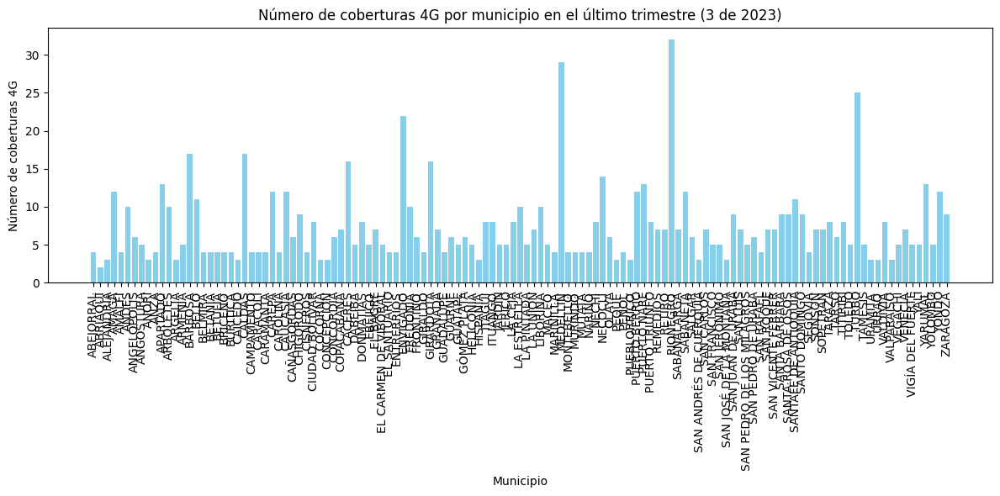

In [ ]:
# Filtrar por años 2022 y 2023
df_filtrado = df[df['AÑO'].isin([2023])]

# Filtrar para el departamento de antioquia
df_filtrado = df_filtrado[df_filtrado['DEPARTAMENTO'] == 'ANTIOQUIA']

# Obtener el último trimestre disponible
ultimo_trimestre = df_filtrado['TRIMESTRE'].max()

# Filtrar por el último trimestre y cobertura 4G
df_ultimo_trimestre = df_filtrado[(df_filtrado['TRIMESTRE'] == ultimo_trimestre) & (df_filtrado['COBERTURA_4G'] == 'S')]

# Agrupar por municipio y contar el número de coberturas 4G
df_4G_por_municipio = df_ultimo_trimestre.groupby('MUNICIPIO').size().reset_index(name='NUM_COBERTURAS_4G')

# Mostrar el resultado
print(f"Número de coberturas 4G por municipio en el último trimestre ({ultimo_trimestre})")
print("---------------------------------------------------")
print(df_4G_por_municipio)
print("---------------------------------------------------")

# Graficar los resultados
plt.figure(figsize=(12, 6))

# Crear una gráfica de barras
plt.bar(df_4G_por_municipio['MUNICIPIO'], df_4G_por_municipio['NUM_COBERTURAS_4G'], color='skyblue')

# Añadir etiquetas y título
plt.xlabel('Municipio')
plt.ylabel('Número de coberturas 4G')
plt.title(f'Número de coberturas 4G por municipio en el último trimestre ({ultimo_trimestre} de 2023)')
plt.xticks(rotation=90)  # Rotar las etiquetas del eje X para mejor legibilidad
plt.tight_layout()  # Ajustar el layout para que no se superpongan elementos
plt.show()

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json
import pandas as pd

# Cargar el archivo GeoJSON de Colombia (asegúrate de que el archivo esté en el mismo directorio)
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Verificar que los nombres de los municipios coincidan entre el GeoJSON y el DataFrame
df_4G_por_municipio["MUNICIPIO"] = df_4G_por_municipio["MUNICIPIO"].str.upper()

# Asignar un ID a cada municipio en el GeoJSON (basado en los nombres)
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con la columna del DataFrame

# Crear la figura del mapa
fig = go.Figure(go.Choroplethmapbox(
    geojson=antioquia_geojson,  # GeoJSON con los municipios de Antioquia
    locations=df_4G_por_municipio["MUNICIPIO"],  # Nombres de los municipios en el DataFrame
    z=df_4G_por_municipio["NUM_COBERTURAS_4G"],  # Datos de cobertura 4G
    colorscale="Viridis",  # Escala de colores
    colorbar_title="Número de coberturas 4G",  # Título de la barra de colores
    marker_opacity=0.6,  # Opacidad de las regiones
    marker_line_width=0.5  # Grosor de los bordes
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",  # Estilo del mapa
    mapbox_zoom=7,  # Nivel de zoom inicial
    mapbox_center={"lat": 6.2442, "lon": -75.5812},  # Centrar el mapa en Antioquia (Medellín)
    title="Número de coberturas 4G por municipio en el trimestre 3 de 2023"  # Título del mapa
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cobertura_4g_antioquia.html")


'mapa_cobertura_4g_antioquia.html'

In [ ]:
# Contar municipios en el DataFrame
num_municipios_df = df_4G_por_municipio["MUNICIPIO"].nunique()
print(f"Número de municipios en el DataFrame: {num_municipios_df}")

# Contar municipios en el GeoJSON
num_municipios_geojson = len(antioquia_geojson["features"])
print(f"Número de municipios en el GeoJSON: {num_municipios_geojson}")

# Nombres de municipios en el DataFrame
print("Municipios en el DataFrame:")
print(df_4G_por_municipio["MUNICIPIO"].unique())

# Nombres de municipios en el GeoJSON
print("\nMunicipios en el GeoJSON:")
print([loc["properties"]["MPIO_CNMBR"] for loc in antioquia_geojson["features"]])

# Normalizar nombres en el DataFrame (eliminando "Ñ" y "ñ")
df_4G_por_municipio["MUNICIPIO"] = (
    df_4G_por_municipio["MUNICIPIO"]
    .str.upper()  # Convertir a mayúsculas
    .str.normalize("NFKD")  # Normalizar caracteres (quitar acentos)
    .str.encode("ascii", errors="ignore")  # Eliminar caracteres no ASCII
    .str.decode("utf-8")  # Volver a cadena de texto
    .str.replace("Ñ", "N")  # Reemplazar "Ñ" por "N"
    .str.replace("ñ", "n")  # Reemplazar "ñ" por "n" (por si acaso)
)

# Verificar los nombres normalizados
print("Municipios en el DataFrame después de normalizar:")
print(df_4G_por_municipio["MUNICIPIO"].unique())



Número de municipios en el DataFrame: 125
Número de municipios en el GeoJSON: 125
Municipios en el DataFrame:
['ABEJORRAL' 'ABRIAQUÍ' 'ALEJANDRÍA' 'AMAGÁ' 'AMALFI' 'ANDES'
 'ANGELÓPOLIS' 'ANGOSTURA' 'ANORÍ' 'ANZA' 'APARTADÓ' 'ARBOLETES' 'ARGELIA'
 'ARMENIA' 'BARBOSA' 'BELLO' 'BELMIRA' 'BETANIA' 'BETULIA' 'BRICEÑO'
 'BURITICÁ' 'CAICEDO' 'CALDAS' 'CAMPAMENTO' 'CARACOLÍ' 'CARAMANTA'
 'CAREPA' 'CAROLINA' 'CAUCASIA' 'CAÑASGORDAS' 'CHIGORODÓ' 'CISNEROS'
 'CIUDAD BOLÍVAR' 'COCORNÁ' 'CONCEPCIÓN' 'CONCORDIA' 'COPACABANA'
 'CÁCERES' 'DABEIBA' 'DONMATÍAS' 'EBÉJICO' 'EL BAGRE'
 'EL CARMEN DE VIBORAL' 'EL SANTUARIO' 'ENTRERRIOS' 'ENVIGADO' 'FREDONIA'
 'FRONTINO' 'GIRALDO' 'GIRARDOTA' 'GRANADA' 'GUADALUPE' 'GUARNE' 'GUATAPE'
 'GÓMEZ PLATA' 'HELICONIA' 'HISPANIA' 'ITAGUI' 'ITUANGO' 'JARDÍN' 'JERICÓ'
 'LA CEJA' 'LA ESTRELLA' 'LA PINTADA' 'LA UNIÓN' 'LIBORINA' 'MACEO'
 'MARINILLA' 'MEDELLÍN' 'MONTEBELLO' 'MURINDÓ' 'MUTATÁ' 'NARIÑO' 'NECHÍ'
 'NECOCLÍ' 'OLAYA' 'PEQUE' 'PEÑOL' 'PUEBLORRICO' 'PUERTO BERRÍO

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json
import pandas as pd

# Cargar el archivo GeoJSON de municipios de Colombia
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Asegurar que los nombres de municipios coincidan entre GeoJSON y DataFrame
df_4G_por_municipio["MUNICIPIO"] = df_4G_por_municipio["MUNICIPIO"].str.upper()

# Asignar un ID a cada municipio en el GeoJSON
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con el DataFrame

# Crear la figura del mapa
fig = go.Figure()

# Mapa de cobertura 4G
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_4G_por_municipio["MUNICIPIO"],  # Nombres de los municipios
    z=df_4G_por_municipio["NUM_COBERTURAS_4G"],  # Datos de cobertura 4G
    colorscale="Viridis",
    colorbar_title="Número de coberturas 4G",
    marker_opacity=0.6,
    marker_line_width=0.5
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=6,
    mapbox_center={"lat": 6.9942, "lon": -75.5812},  # Centrar el mapa en Antioquia
    title="Número de coberturas 4G en Antioquia por municipio en el trimestre 3 de 2023)"  # Título del mapa
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cobertura_4g_antioquia.html")

'mapa_cobertura_4g_antioquia.html'

In [ ]:
# Municipios en el DataFrame
municipios_df = set(df_4G_por_municipio["MUNICIPIO"].unique())

# Municipios en el GeoJSON (corregidos)
municipios_geojson = set(loc["properties"]["MPIO_CNMBR"] for loc in antioquia_geojson["features"])

# Municipios en el DataFrame que no están en el GeoJSON
print("Municipios en el DataFrame que no están en el GeoJSON:")
print(municipios_df - municipios_geojson)

# Municipios en el GeoJSON que no están en el DataFrame
print("\nMunicipios en el GeoJSON que no están en el DataFrame:")
print(municipios_geojson - municipios_df)

Municipios en el DataFrame que no están en el GeoJSON:
{'SANTA ROSA DE OSOS', 'DONMATIAS', 'BRICENO', 'EL SANTUARIO', 'PENOL', 'CANASGORDAS', 'SAN PEDRO DE LOS MILAGROS', 'SAN VICENTE FERRER', 'NARINO', 'SAN ANDRES DE CUERQUIA', 'EL CARMEN DE VIBORAL', 'SAN JOSE DE LA MONTANA'}

Municipios en el GeoJSON que no están en el DataFrame:
{'SAN VICENTE', 'CARMEN DE VIBORAL', 'SAN JOSE DE LA MONTAÑA', 'SAN PEDRO', 'BRICEÑO', 'SANTA.ROSA DE OSOS', 'SANTUARIO', 'CAÑASGORDAS', 'NARIÑO', 'DON MATIAS', 'SAN ANDRES', 'PEÑOL'}


In [ ]:
# Diccionario de correcciones
correcciones = {
    "SAN PEDRO DE LOS MILAGROS": "SAN PEDRO",
    "EL SANTUARIO": "SANTUARIO",
    "NARINO": "NARIÑO",
    "BRICENO": "BRICEÑO",
    "CANASGORDAS": "CAÑASGORDAS",
    "PENOL": "PEÑOL",
    "EL CARMEN DE VIBORAL": "CARMEN DE VIBORAL",
    "DONMATIAS": "DON MATIAS",
    "SANTA ROSA DE OSOS": "SANTA.ROSA DE OSOS",
    "SAN ANDRES DE CUERQUIA": "SAN ANDRES",
    "SAN JOSE DE LA MONTANA": "SAN JOSE DE LA MONTAÑA",
    "SAN VICENTE FERRER": "SAN VICENTE"
}

# Aplicar las correcciones al DataFrame
df_4G_por_municipio["MUNICIPIO"] = df_4G_por_municipio["MUNICIPIO"].replace(correcciones)

# Verificar los nombres corregidos
print("Municipios en el DataFrame después de corregir:")
print(df_4G_por_municipio["MUNICIPIO"].unique())

Municipios en el DataFrame después de corregir:
['ABEJORRAL' 'ABRIAQUI' 'ALEJANDRIA' 'AMAGA' 'AMALFI' 'ANDES'
 'ANGELOPOLIS' 'ANGOSTURA' 'ANORI' 'ANZA' 'APARTADO' 'ARBOLETES' 'ARGELIA'
 'ARMENIA' 'BARBOSA' 'BELLO' 'BELMIRA' 'BETANIA' 'BETULIA' 'BRICEÑO'
 'BURITICA' 'CAICEDO' 'CALDAS' 'CAMPAMENTO' 'CARACOLI' 'CARAMANTA'
 'CAREPA' 'CAROLINA' 'CAUCASIA' 'CAÑASGORDAS' 'CHIGORODO' 'CISNEROS'
 'CIUDAD BOLIVAR' 'COCORNA' 'CONCEPCION' 'CONCORDIA' 'COPACABANA'
 'CACERES' 'DABEIBA' 'DON MATIAS' 'EBEJICO' 'EL BAGRE' 'CARMEN DE VIBORAL'
 'SANTUARIO' 'ENTRERRIOS' 'ENVIGADO' 'FREDONIA' 'FRONTINO' 'GIRALDO'
 'GIRARDOTA' 'GRANADA' 'GUADALUPE' 'GUARNE' 'GUATAPE' 'GOMEZ PLATA'
 'HELICONIA' 'HISPANIA' 'ITAGUI' 'ITUANGO' 'JARDIN' 'JERICO' 'LA CEJA'
 'LA ESTRELLA' 'LA PINTADA' 'LA UNION' 'LIBORINA' 'MACEO' 'MARINILLA'
 'MEDELLIN' 'MONTEBELLO' 'MURINDO' 'MUTATA' 'NARIÑO' 'NECHI' 'NECOCLI'
 'OLAYA' 'PEQUE' 'PEÑOL' 'PUEBLORRICO' 'PUERTO BERRIO' 'PUERTO NARE'
 'PUERTO TRIUNFO' 'REMEDIOS' 'RETIRO' 'RIONEGRO' 'S

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json
import pandas as pd

# Cargar el archivo GeoJSON de municipios de Colombia
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Asegurar que los nombres de municipios coincidan entre GeoJSON y DataFrame
df_4G_por_municipio["MUNICIPIO"] = df_4G_por_municipio["MUNICIPIO"].str.upper()

# Asignar un ID a cada municipio en el GeoJSON
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con el DataFrame

# Crear la figura del mapa
fig = go.Figure()

# Mapa de cobertura 4G
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_4G_por_municipio["MUNICIPIO"],  # Nombres de los municipios
    z=df_4G_por_municipio["NUM_COBERTURAS_4G"],  # Datos de cobertura 4G
    colorscale="Viridis",
    colorbar_title="Número de coberturas 4G",
    marker_opacity=0.8,
    marker_line_width=0.5
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=6,
    mapbox_center={"lat": 6.9942, "lon": -75.5812},  # Centrar el mapa en Antioquia
    title="Número de coberturas 4G en Antioquia por municipio en el trimestre 3 de 2023)"  # Título del mapa
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cobertura_4g_antioquia.html")

'mapa_cobertura_4g_antioquia.html'

In [ ]:
# Filtrar por año 2023, departamento Antioquia y cobertura 4G
df_filtrado = df[df['AÑO'].isin([2023])]
df_filtrado = df_filtrado[df_filtrado['DEPARTAMENTO'] == 'ANTIOQUIA']

# Obtener el último trimestre disponible
ultimo_trimestre = df_filtrado['TRIMESTRE'].max()

# Filtrar por el último trimestre cabeceras municipales
df_ultimo_trimestre_S = df_filtrado[(df_filtrado['TRIMESTRE'] == ultimo_trimestre) & (df_filtrado['CABECERA_MUNICIPAL'] == 'S') & (df_filtrado['COBERTURA_4G'] == 'S')]
# Obtener los nombres de los municipios
nombres_municipios_S = df_ultimo_trimestre_S['MUNICIPIO'].unique()
print(nombres_municipios_S)

# Filtrar por el último trimestre no cabeceras municipales
df_ultimo_trimestre_N = df_filtrado[(df_filtrado['TRIMESTRE'] == ultimo_trimestre) & (df_filtrado['CABECERA_MUNICIPAL'] == 'N') & (df_filtrado['COBERTURA_4G'] == 'S')]
nombres_municipios_N = df_ultimo_trimestre_S['MUNICIPIO'].unique()
print(nombres_municipios_N)

['PUEBLORRICO' 'CAREPA' 'NARIÑO' 'PEQUE' 'GIRALDO' 'ENVIGADO' 'AMALFI'
 'HELICONIA' 'BELMIRA' 'ENTRERRIOS' 'SAN JERÓNIMO' 'ITUANGO' 'VALDIVIA'
 'CARACOLÍ' 'PUERTO BERRÍO' 'TARAZÁ' 'CARAMANTA' 'VENECIA' 'VALPARAÍSO'
 'MUTATÁ' 'BETANIA' 'SANTA ROSA DE OSOS' 'EBÉJICO' 'MARINILLA' 'GUATAPE'
 'TITIRIBÍ' 'SANTAFÉ DE ANTIOQUIA' 'SAN JOSÉ DE LA MONTAÑA' 'BELLO'
 'LA PINTADA' 'TOLEDO' 'YONDÓ' 'MEDELLÍN' 'YOLOMBÓ' 'GRANADA' 'TURBO'
 'LA UNIÓN' 'GIRARDOTA' 'DABEIBA' 'SAN PEDRO DE LOS MILAGROS' 'CAUCASIA'
 'CIUDAD BOLÍVAR' 'URRAO' 'ANZA' 'PEÑOL' 'APARTADÓ' 'LA ESTRELLA'
 'SABANALARGA' 'SAN ROQUE' 'CHIGORODÓ' 'SANTO DOMINGO' 'NECHÍ' 'FREDONIA'
 'LA CEJA' 'ABRIAQUÍ' 'CAROLINA' 'FRONTINO' 'ALEJANDRÍA' 'REMEDIOS'
 'EL BAGRE' 'SEGOVIA' 'SAN LUIS' 'EL SANTUARIO' 'YALÍ' 'TÁMESIS'
 'HISPANIA' 'SAN VICENTE FERRER' 'SAN RAFAEL' 'DONMATÍAS' 'ARGELIA'
 'SAN JUAN DE URABÁ' 'SAN CARLOS' 'AMAGÁ' 'CISNEROS' 'CALDAS' 'NECOCLÍ'
 'LIBORINA' 'GÓMEZ PLATA' 'TARSO' 'ANORÍ' 'ARBOLETES' 'SONSON' 'MACEO'
 'SALGAR' 'ARMENI

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json
import pandas as pd

# Cargar el archivo GeoJSON de municipios de Colombia
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Asignar un ID a cada municipio en el GeoJSON
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con el DataFrame

# Crear la figura del mapa
fig = go.Figure()

# Agregar municipios con CABECERA_MUNICIPAL = "S" (color verde)
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_ultimo_trimestre_S["MUNICIPIO"],  # Nombres de los municipios
    z=[1] * len(df_ultimo_trimestre_S),  # Asignar un valor constante para el color
    colorscale=[[0, "green"], [1, "green"]],  # Color verde para "S"
    marker_opacity=0.6,
    marker_line_width=0.5,
    name="Cabecera Municipal S",
    showscale=False  # Ocultar la barra de color
))

# Agregar municipios con CABECERA_MUNICIPAL = "N" (color azul)
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_ultimo_trimestre_N["MUNICIPIO"],  # Nombres de los municipios
    z=[1] * len(df_ultimo_trimestre_N),  # Asignar un valor constante para el color
    colorscale=[[0, "blue"], [1, "blue"]],  # Color azul para "N"
    marker_opacity=0.6,
    marker_line_width=0.5,
    name="Cabecera Municipal N",
    showscale=False  # Ocultar la barra de color
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=6,
    mapbox_center={"lat": 6.9942, "lon": -75.5812},  # Centrar el mapa en Antioquia (Medellín)
    title="Número de coberturas 4G en Antioquia por municipio en el trimestre 3 de 2023)"  # Título del mapa
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cabeceras_municipales.html")

'mapa_cabeceras_municipales.html'

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json
import pandas as pd

# Cargar el archivo GeoJSON de municipios de Colombia
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Contar municipios en el GeoJSON
num_municipios_geojson = len(antioquia_geojson["features"])
print(f"Número de municipios en el GeoJSON: {num_municipios_geojson}")

# Nombres de municipios en el GeoJSON
print("\nMunicipios en el GeoJSON:")
print([loc["properties"]["MPIO_CNMBR"] for loc in antioquia_geojson["features"]])

# Filtrar por año 2023, departamento Antioquia y cobertura 4G
df_filtrado = df[df['AÑO'].isin([2023])]
df_filtrado = df_filtrado[df_filtrado['DEPARTAMENTO'] == 'ANTIOQUIA']

# Obtener el último trimestre disponible
ultimo_trimestre = df_filtrado['TRIMESTRE'].max()

# Filtrar por el último trimestre y cobertura 4G
df_ultimo_trimestre = df_filtrado[(df_filtrado['TRIMESTRE'] == ultimo_trimestre) & (df_filtrado['COBERTURA_4G'] == 'S')]

# Agrupar por municipio y contar el número de coberturas 4G
df_4G_por_municipio = df_ultimo_trimestre.groupby('MUNICIPIO').agg(
    NUM_COBERTURAS_4G=('COBERTURA_4G', 'size'),
    CABECERA_MUNICIPAL=('CABECERA_MUNICIPAL', 'first')  # Tomar el primer valor de "CABECERA MUNICIPAL"
).reset_index()

# Contar municipios en el DataFrame
num_municipios_df = df_4G_por_municipio["MUNICIPIO"].nunique()
print(f"Número de municipios en el DataFrame: {num_municipios_df}")

# Nombres de municipios en el DataFrame
print("Municipios en el DataFrame:")
print(df_4G_por_municipio["MUNICIPIO"].unique())

# Normalizar nombres en el DataFrame (eliminando "Ñ" y "ñ")
df_4G_por_municipio["MUNICIPIO"] = (
    df_4G_por_municipio["MUNICIPIO"]
    .str.upper()  # Convertir a mayúsculas
    .str.normalize("NFKD")  # Normalizar caracteres (quitar acentos)
    .str.encode("ascii", errors="ignore")  # Eliminar caracteres no ASCII
    .str.decode("utf-8")  # Volver a cadena de texto
    .str.replace("Ñ", "N")  # Reemplazar "Ñ" por "N"
    .str.replace("ñ", "n")  # Reemplazar "ñ" por "n" (por si acaso)
)

# Verificar los nombres normalizados
print("Municipios en el DataFrame después de normalizar:")
print(df_4G_por_municipio["MUNICIPIO"].unique())

# Diccionario de correcciones
correcciones = {
    "SAN PEDRO DE LOS MILAGROS": "SAN PEDRO",
    "EL SANTUARIO": "SANTUARIO",
    "NARINO": "NARIÑO",
    "BRICENO": "BRICEÑO",
    "CANASGORDAS": "CAÑASGORDAS",
    "PENOL": "PEÑOL",
    "EL CARMEN DE VIBORAL": "CARMEN DE VIBORAL",
    "DONMATIAS": "DON MATIAS",
    "SANTA ROSA DE OSOS": "SANTA.ROSA DE OSOS",
    "SAN ANDRES DE CUERQUIA": "SAN ANDRES",
    "SAN JOSE DE LA MONTANA": "SAN JOSE DE LA MONTAÑA",
    "SAN VICENTE FERRER": "SAN VICENTE"
}

# Aplicar las correcciones al DataFrame
df_4G_por_municipio["MUNICIPIO"] = df_4G_por_municipio["MUNICIPIO"].replace(correcciones)

# Verificar los nombres corregidos
print("Municipios en el DataFrame después de corregir:")
print(df_4G_por_municipio["MUNICIPIO"].unique())

# Asignar un ID a cada municipio en el GeoJSON
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con el DataFrame

# Crear la figura del mapa
fig = go.Figure()

# Capa 1: Municipios con CABECERA_MUNICIPAL = "S" (color verde)
df_cabecera_S = df_4G_por_municipio[df_4G_por_municipio["CABECERA_MUNICIPAL"] == "S"]
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_cabecera_S["MUNICIPIO"],  # Nombres de los municipios
    z=[1] * len(df_cabecera_S),  # Asignar un valor constante para el color
    colorscale=[[0, "green"], [1, "green"]],  # Color verde para "S"
    marker_opacity=0.6,
    marker_line_width=0.5,
    name="Cabecera Municipal (S)",
    showscale=False  # Ocultar la barra de color
))

# Capa 2: Municipios con CABECERA_MUNICIPAL = "N" (color azul)
df_cabecera_N = df_4G_por_municipio[df_4G_por_municipio["CABECERA_MUNICIPAL"] == "N"]
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_cabecera_N["MUNICIPIO"],  # Nombres de los municipios
    z=[1] * len(df_cabecera_N),  # Asignar un valor constante para el color
    colorscale=[[0, "blue"], [1, "blue"]],  # Color azul para "N"
    marker_opacity=0.6,
    marker_line_width=0.5,
    name="No Cabecera Municipal (N)",
    showscale=False  # Ocultar la barra de color
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=6,
    mapbox_center={"lat": 6.9942, "lon": -75.5812},  # Centrar el mapa en Antioquia
    title=f"Cobertura 4G por municipio en Antioquia (Trimestre {ultimo_trimestre})"
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cabeceras_municipales.html")

Número de municipios en el GeoJSON: 125

Municipios en el GeoJSON:
['MEDELLIN', 'CIUDAD BOLIVAR', 'BRICEÑO', 'BURITICA', 'CACERES', 'BETULIA', 'BETANIA', 'BELLO', 'BELMIRA', 'BARBOSA', 'ARMENIA', 'ARGELIA', 'ARBOLETES', 'ANZA', 'SANTAFE DE ANTIOQUIA', 'ANORI', 'ANGOSTURA', 'ANGELOPOLIS', 'ANDES', 'AMALFI', 'AMAGA', 'ALEJANDRIA', 'ABRIAQUI', 'ABEJORRAL', 'ZARAGOZA', 'YONDO', 'YOLOMBO', 'YARUMAL', 'YALI', 'VENECIA', 'VEGACHI', 'VALPARAISO', 'VALDIVIA', 'URAMITA', 'TURBO', 'TOLEDO', 'TITIRIBI', 'TARSO', 'TARAZA', 'TAMESIS', 'SOPETRAN', 'SONSON', 'SEGOVIA', 'SANTUARIO', 'SANTO DOMINGO', 'SANTA.ROSA DE OSOS', 'SANTA BARBARA', 'GIRALDO', 'FREDONIA', 'ENVIGADO', 'ENTRERRIOS', 'EL BAGRE', 'EBEJICO', 'DON MATIAS', 'COPACABANA', 'CONCORDIA', 'CONCEPCION', 'COCORNA', 'CISNEROS', 'CHIGORODO', 'CAUCASIA', 'CAROLINA', 'CARMEN DE VIBORAL', 'CAREPA', 'CARAMANTA', 'CARACOLI', 'CAÑASGORDAS', 'CAMPAMENTO', 'CALDAS', 'CAICEDO', 'SAN VICENTE', 'SAN ROQUE', 'SAN RAFAEL', 'SAN PEDRO DE URABA', 'SAN PEDRO', '

'mapa_cabeceras_municipales.html'

In [ ]:
import pandas as pd
import plotly.express as px

# Paso 1: Filtrar los datos para el año 2023 y trimestre 3
df_filtrado = df[(df['AÑO'] == 2023) & (df['TRIMESTRE'] == 3) & (df['DEPARTAMENTO'] == 'ANTIOQUIA')]# 1. Filtrar solo el departamento de Antioquia

# Normalizar nombres en el DataFrame (eliminando "Ñ" y "ñ")
df_filtrado["MUNICIPIO"] = (
    df_filtrado["MUNICIPIO"]
    .str.upper()  # Convertir a mayúsculas
    .str.normalize("NFKD")  # Normalizar caracteres (quitar acentos)
    .str.encode("ascii", errors="ignore")  # Eliminar caracteres no ASCII
    .str.decode("utf-8")  # Volver a cadena de texto
    .str.replace("Ñ", "N")  # Reemplazar "Ñ" por "N"
    .str.replace("ñ", "n")  # Reemplazar "ñ" por "n" (por si acaso)
)

# Diccionario de correcciones
correcciones = {
    "SAN PEDRO DE LOS MILAGROS": "SAN PEDRO",
    "EL SANTUARIO": "SANTUARIO",
    "NARINO": "NARIÑO",
    "BRICENO": "BRICEÑO",
    "CANASGORDAS": "CAÑASGORDAS",
    "PENOL": "PEÑOL",
    "EL CARMEN DE VIBORAL": "CARMEN DE VIBORAL",
    "DONMATIAS": "DON MATIAS",
    "SANTA ROSA DE OSOS": "SANTA.ROSA DE OSOS",
    "SAN ANDRES DE CUERQUIA": "SAN ANDRES",
    "SAN JOSE DE LA MONTANA": "SAN JOSE DE LA MONTAÑA",
    "SAN VICENTE FERRER": "SAN VICENTE"
}

# Aplicar las correcciones al DataFrame
df_filtrado["MUNICIPIO"] = df_filtrado["MUNICIPIO"].replace(correcciones)

# Paso 2: Agrupar los datos por municipio y calcular estadísticas
df_agrupado = df_filtrado.groupby('MUNICIPIO').agg(
    total_centros_poblados=('CENTRO_POBLADO', 'size'),  # Total de centros poblados por municipio
    total_cabeceras=('CABECERA_MUNICIPAL', lambda x: (x == 'S').sum()),  # Total de cabeceras municipales
    total_no_cabeceras=('CABECERA_MUNICIPAL', lambda x: (x == 'N').sum()),  # Total de no cabeceras municipales
    cabeceras_con_cobertura_4G=('CABECERA_MUNICIPAL', lambda x: ((x == 'S') & (df_filtrado.loc[x.index, 'COBERTURA_4G'] == 'S')).sum()),  # Cabeceras con cobertura 4G
    no_cabeceras_con_cobertura_4G=('CABECERA_MUNICIPAL', lambda x: ((x == 'N') & (df_filtrado.loc[x.index, 'COBERTURA_4G'] == 'S')).sum()),  # No cabeceras con cobertura 4G
    total_cobertura_4G=('COBERTURA_4G', lambda x: (x == 'S').sum())  # Conteo de cobertura 4G por municipio
).reset_index()
df_agrupado


# Paso 3: Calcular porcentajes relativos
df_agrupado['porcentaje_cobertura_4G_total'] = (df_agrupado['total_cobertura_4G'] / df_agrupado['total_centros_poblados']) * 100
df_agrupado['porcentaje_cabeceras_cobertura_4G'] = (df_agrupado['cabeceras_con_cobertura_4G'] / df_agrupado['total_cabeceras']) * 100
df_agrupado['porcentaje_no_cabeceras_cobertura_4G'] = (df_agrupado['no_cabeceras_con_cobertura_4G'] / df_agrupado['total_no_cabeceras']) * 100

# Mostrar el DataFrame con los resultados
print(df_agrupado)

# Paso 4: Visualizar los resultados
# Gráfico de barras para el porcentaje de cobertura 4G en cabeceras municipales
fig1 = px.bar(
    df_agrupado,
    x='MUNICIPIO',
    y='porcentaje_cobertura_4G_total',
    title='Porcentaje de Centros poblados con cobertura 4G (2023, Trimestre 3) por municipio',
    labels={'porcentaje_cabeceras_cobertura_4G': 'Porcentaje de cobertura 4G', 'MUNICIPIO': 'Municipio'}
)
fig1.show()

# Gráfico de barras apiladas para distinguir entre cabeceras y no cabeceras
fig2 = px.bar(
    df_agrupado,
    x='MUNICIPIO',
    y=['porcentaje_cabeceras_cobertura_4G', 'porcentaje_no_cabeceras_cobertura_4G'],
    title='Porcentaje de cobertura 4G por municipio (Cabeceras vs No Cabeceras) - 2023, Trimestre 3',
    labels={'value': 'Porcentaje de cobertura 4G', 'MUNICIPIO': 'Municipio'},
    barmode='stack'
)
fig2.show()

<ipython-input-19-3b3d4dfc69c3>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-19-3b3d4dfc69c3>:35: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



      MUNICIPIO  total_centros_poblados  total_cabeceras  total_no_cabeceras  \
0     ABEJORRAL                       7                4                   3   
1      ABRIAQUI                       4                4                   0   
2    ALEJANDRIA                       4                4                   0   
3         AMAGA                      12                4                   8   
4        AMALFI                       4                4                   0   
..          ...                     ...              ...                 ...   
120        YALI                       5                4                   1   
121     YARUMAL                      14                4                  10   
122     YOLOMBO                       6                4                   2   
123       YONDO                      12                4                   8   
124    ZARAGOZA                       9                4                   5   

     cabeceras_con_cobertura_4G  no_cab

In [ ]:
import plotly.graph_objs as go
import plotly.offline as pyo
import json

# Cargar el archivo GeoJSON de municipios de Colombia
with open("Municipios.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Filtrar solo los municipios de Antioquia
antioquia_geojson = {
    "type": "FeatureCollection",
    "features": [feature for feature in geojson_data["features"] if feature["properties"]["DEPTO"] == "ANTIOQUIA"]
}

# Asignar un ID a cada municipio en el GeoJSON
for loc in antioquia_geojson["features"]:
    loc["id"] = loc["properties"]["MPIO_CNMBR"]  # Asegurar que coincide con el DataFrame

# Crear la figura del mapa
fig = go.Figure()

# Capa 1: Porcentaje de cobertura 4G en cabeceras municipales
fig.add_trace(go.Choroplethmapbox(
    geojson=antioquia_geojson,
    locations=df_agrupado["MUNICIPIO"],  # Nombres de los municipios
    z=df_agrupado["porcentaje_cobertura_4G_total"],  # Porcentaje total de centros poblados con cobertura 4G por municipio
    colorscale="Viridis",  # Escala de colores
    colorbar_title="Porcentaje de cobertura 4G",
    marker_opacity=0.6,
    marker_line_width=0.5,
    name="Cabeceras Municipales con Cobertura 4G"
))

# Configurar el estilo del mapa
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_zoom=6,
    mapbox_center={"lat": 6.9942, "lon": -75.5812},  # Centrar el mapa en Antioquia (Medellín)
    title='Porcentaje de Centros poblados con cobertura 4G por total de Centros poblados en el municipio (2023, Trimestre 3)'
)

# Mostrar el mapa
fig.show()

# Exportar el mapa a un archivo HTML
pyo.plot(fig, filename="mapa_cabeceras_cobertura_4G.html")

'mapa_cabeceras_cobertura_4G.html'

In [ ]:
import plotly.express as px

# Crear una columna de categoría según el porcentaje de cobertura 4G total
df_agrupado['categoria_cobertura'] = df_agrupado['porcentaje_cobertura_4G_total'].apply(
    lambda x: '≥ 80%' if x >= 80 else '< 80%'
)

# Contar los municipios en cada categoría
conteo_categorias = df_agrupado['categoria_cobertura'].value_counts().reset_index()
conteo_categorias.columns = ['categoria', 'cantidad_municipios']

# Mostrar el conteo de categorías
print(conteo_categorias)

# Graficar en un diagrama de Pie
fig = px.pie(
    conteo_categorias,
    values='cantidad_municipios',
    names='categoria',
    title='Distribución de municipios según cobertura 4G total (2023, Trimestre 3)',
    labels={'categoria': 'Categoría de cobertura', 'cantidad_municipios': 'Cantidad de municipios'},
    color_discrete_sequence=px.colors.qualitative.Pastel  # Colores pastel para el gráfico
)

# Mostrar el gráfico
fig.show()

SyntaxError: unmatched ')' (<ipython-input-1-a35077a93b18>, line 1)

In [ ]:
    import numpy as np
    import pandas as pd

    # Datos de calidad de la conectividad
    calidad_conectividad = {
        "Municipio": [
            "Medellín", "Abejorral", "Abriaquí", "Alejandría", "Amagá", "Amalfi", "Andes", "Angelópolis", "Angostura", "Anorí",
            "Santa Fé de Antioquia", "Anzá", "Apartadó", "Argelia", "Armenia", "Barbosa", "Belmira", "Bello", "Betania", "Betulia",
            "Briceño", "Buriticá", "Cáceres", "Caicedo", "Caldas", "Cañasgordas", "Caracolí", "Caramanta", "Carepa", "El Carmen de Viboral",
            "Carolina", "Caucasia", "Chigorodó", "Cisneros", "Cocorná", "Concepción", "Concordia", "Copacabana", "Dabeiba", "Donmatías",
            "Ebéjico", "El Bagre", "Entrerríos", "Envigado", "Fredonia", "Frontino", "Girardota", "Gómez Plata", "Granada", "Guadalupe",
            "Guarne", "Guatapé", "Heliconia", "Hispania", "Itagüí", "Ituango", "Jardín", "La Ceja", "La Estrella", "La Pintada",
            "La Unión", "Liborina", "Maceo", "Marinilla", "Montebello", "Murindó", "Nariño", "Necoclí", "Nechí", "Peñol",
            "Pueblorrico", "Puerto Berrío", "Puerto Nare", "Puerto Triunfo", "Retiro", "Rionegro", "Sabanalarga", "Sabaneta", "Salgar", "San Andrés de Cuerquía",
            "San Francisco", "San Jerónimo", "San José de la Montaña", "San Juan de Urabá", "San Luis", "San Pedro de Urabá", "San Roque", "San Vicente Ferrer", "Santa Bárbara", "Santa Rosa de Osos",
            "El Santuario", "Segovia", "Sonsón", "Sopetrán", "Támesis", "Tarazá", "Tarso", "Titiribí", "Toledo", "Turbo",
            "Uramita", "Urrao", "Valdivia", "Valparaíso", "Vegachí", "Venecia", "Yalí", "Yarumal", "Yolombó", "Yondó", "Zaragoza"
        ],
        "Nivel de Desempeño de Calidad": [
            "Alto", "Medio", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Medio", "Bajo",
            "Bajo", "Bajo", "Bajo", "Medio", "Medio", "Bajo", "Bajo", "Alto", "Medio", "Medio",
            "Medio", "Medio", "Medio", "Medio", "Alto", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo",
            "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Medio", "Alto", "Bajo", "Bajo",
            "Medio", "Bajo", "Medio", "Alto", "Medio", "Bajo", "Alto", "Bajo", "Medio", "Medio",
            "Bajo", "Alto", "Medio", "Bajo", "Alto", "Medio", "Bajo", "Alto", "Alto", "Bajo",
            "Bajo", "Medio", "Medio", "Bajo", "Medio", "Bajo", "Medio", "Bajo", "Bajo", "Bajo",
            "Medio", "Bajo", "Bajo", "Bajo", "Alto", "Alto", "Medio", "Alto", "Medio", "Medio",
            "Medio", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Medio", "Bajo", "Bajo", "Bajo",
            "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Bajo", "Medio", "Bajo",
            "Medio", "Bajo", "Medio", "Medio", "Bajo", "Alto", "Bajo", "Bajo", "Medio", "Bajo",
            "Bajo"
        ]
    }

    # Convertir a DataFrame
    df_calidad = pd.DataFrame(calidad_conectividad)
    df_calidad

,Municipio,Nivel de Desempeño de Calidad
0,Medellín,Alto
1,Abejorral,Medio
2,Abriaquí,Bajo
3,Alejandría,Bajo
4,Amagá,Bajo
...,...,...
106,Yalí,Bajo
107,Yarumal,Bajo
108,Yolombó,Medio
109,Yondó,Bajo
